In [1]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))
%load_ext autoreload
%autoreload 2

In [2]:
%matplotlib inline
import matplotlib.pylab as plt

In [22]:
from Cfg import Cfg
from RecordingCorpus import RecordingCorpus
from multiprocessing import Pool
import warnings
warnings.filterwarnings("ignore")
from SplitCorpus import SplitCorpus
from glob import glob
from load_pretrained_model import load_pretrained_model
import soundfile as sf
import numpy as np
import librosa
from Clip import Clip
import torch
from collect_false import collect_false
from transcribe import transcribe
from play import play

## Load language model

In [4]:
C = Cfg('NIST', 16000, 'pashto', 'build') 

In [5]:
model = load_pretrained_model(C, 0)

searching save/nemo_pashto/*.ckpt


[NeMo W 2020-10-21 13:30:01 modelPT:102] Please call the ModelPT.setup_training_data() method and provide a valid configuration file to setup the train data loader.
    Train config : 
    manifest_filepath: NIST/openasr20_pashto/build/train_manifest.json
    sample_rate: 16000
    labels:
    - غ
    - ش
    - ک
    - ژ
    - ړ
    - ج
    - چ
    - ښ
    - ض
    - ل
    - ئ
    - ڼ
    - ء
    - ې
    - ع
    - ذ
    - ی
    - آ
    - ث
    - ا
    - م
    - څ
    - ه
    - د
    - خ
    - پ
    - ټ
    - س
    - ص
    - ق
    - ز
    - ً
    - ف
    - ت
    - ۍ
    - ګ
    - ځ
    - ي
    - ب
    - ن
    - ر
    - ط
    - ' '
    - ډ
    - و
    - ظ
    - ح
    - ږ
    batch_size: 14
    trim_silence: true
    max_duration: 33.0
    shuffle: true
    is_tarred: false
    tarred_audio_filepaths: null
    num_workers: 16
    
[NeMo W 2020-10-21 13:30:01 modelPT:109] Please call the ModelPT.setup_validation_data() or ModelPT.setup_multiple_validation_data() method and provide a valid c

[NeMo I 2020-10-21 13:30:01 features:241] PADDING: 16
[NeMo I 2020-10-21 13:30:01 features:258] STFT using torch
loaded save/nemo_pashto/pashto_20201018_232300_353596_epoch=189.ckpt


RuntimeError: CUDA error: out of memory

## Start with BUILD to visualize and test transcriptions

In [3]:
if __name__ == '__main__':   
    with Pool(16) as pool:
        recordings = RecordingCorpus(C, pool)

100%|██████████| 131/131 [00:06<00:00, 19.38it/s]


In [8]:
splits=SplitCorpus.transcript_split(C, recordings)

In [23]:
artifact=splits.artifacts[10]

KEY ('pashto', 'BABEL_BP_104_52753_20120213_014050_outLine', (1241040, 1263280))
SOURCE


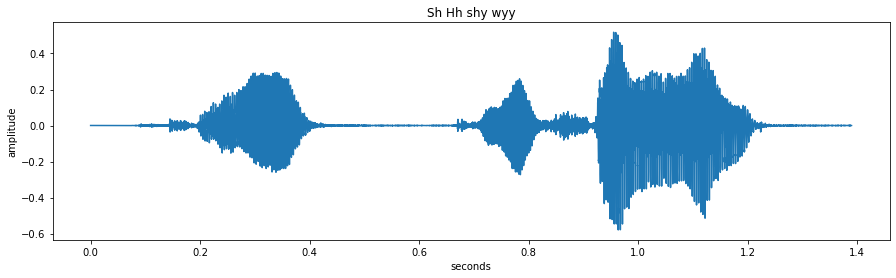

TARGET
ښه څه شی وایي :: Sh Hh shy wyy



In [24]:
artifact.display()

In [32]:
pred=transcribe(C, model, artifact.source.value)
pred

[NeMo I 2020-10-21 00:10:06 collections:173] Dataset loaded with 1 files totalling 27.78 hours
[NeMo I 2020-10-21 00:10:06 collections:174] 0 files were filtered totalling 0.00 hours


'ښه څه شی وایي'

In [34]:
pred==artifact.target.value

True

## Move onto DEV to visualize, test and refine splitter

In [7]:
C = Cfg('NIST', 16000, 'pashto', 'dev') 

In [8]:
if __name__ == '__main__':   
    with Pool(16) as pool:
        recordings = RecordingCorpus(C, pool)

100%|██████████| 136/136 [00:06<00:00, 21.17it/s]


In [9]:
artifact=recordings.artifacts[0]

KEY ('pashto', 'BABEL_BP_104_87723_20120206_183706_outLine')
SOURCE


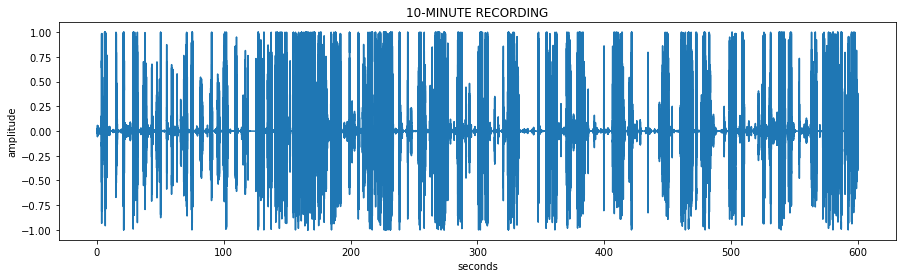

TARGET



In [10]:
artifact.display()

In [11]:
audio=artifact.source.value

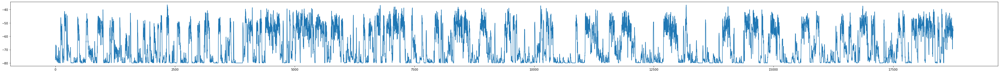

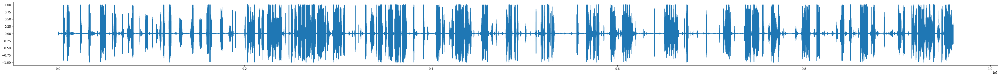

In [12]:
size=audio.shape[0]
max_duration=6
max_samples=int(max_duration*C.sample_rate)
min_samples=int(0.2*C.sample_rate)
T=np.arange(audio.shape[0])/C.sample_rate
S = librosa.feature.melspectrogram(y=audio, sr=C.sample_rate, n_mels=64, fmax=8000)
S_dB = librosa.power_to_db(S, ref=np.max)
s_dB_mean=np.mean(S_dB,axis=0)
plt.figure(figsize=(60,4))
plt.plot(s_dB_mean)
plt.show()
plt.figure(figsize=(60,4))
plt.plot(audio);

In [23]:
cutoff=-70
speech_q=(s_dB_mean>cutoff)
TSQ=T[-1]*np.arange(len(speech_q))/len(speech_q)
silences=T[-1]*collect_false(speech_q)/len(speech_q)

In [24]:
len(silences)

316

In [25]:
S2=[(x,y) for x,y in silences if y-x > 0.2]

In [26]:
S3=int([y for x,y in S2 if y <= max_duration][-1]*C.sample_rate)
S3

94207

In [27]:
clip=audio[0:S3]

In [18]:
S3/C.sample_rate

5.8879375

In [19]:
audio=audio[S3:]

In [20]:
play(clip)

NameError: name 'play' is not defined

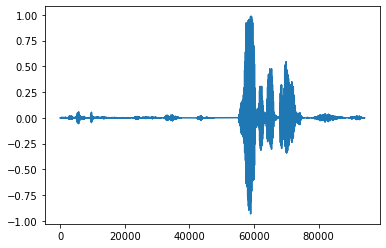

In [21]:
plt.plot(clip)

In [153]:
pred=transcribe(C, model, clip)
print(pred)

[NeMo I 2020-10-21 02:10:13 collections:173] Dataset loaded with 1 files totalling 27.78 hours
[NeMo I 2020-10-21 02:10:13 collections:174] 0 files were filtered totalling 0.00 hours
زه هو کور کښې یم


## Manual clip editor to break down overly long BUILD clips and reduce max_duration for training

## Find long audio short transcription length as candidates for break down

## Find very long transcription clips as candidates for break down

## Find long transcription short audio clips as candidates for rejection

## After as much corpus breakdown as possible, look at bad predictions as possible bad annotations